In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import keras as K
from lime import lime_tabular
import h5py, os

Using TensorFlow backend.


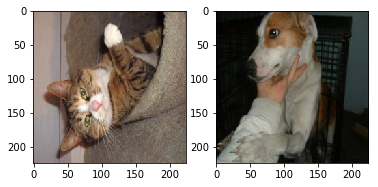

In [2]:
# convert images to and from vgg16 format
def img_to_vgg(img, reverse=False):
    """Preprocess for vgg16"""
    vgg_mean = np.array([123.68, 116.779, 103.939]).reshape((1,1,3))
    if reverse:
        img = img[..., ::-1]
        return (img + vgg_mean).astype(np.uint8)
    else:
        img = img - vgg_mean     # subtract mean
        return img[..., ::-1]    # reverse axis rgb->bgr
def vgg_to_img(img):
    return img_to_vgg(img, True)

# load imgs
hdf5_file = h5py.File("dogs_and_cats.h5", "r")
cats = hdf5_file['cats_img'][()]
dogs = hdf5_file['dogs_img'][()]
hdf5_file.close()

X = np.zeros((len(cats)+len(dogs),224,224,3), dtype=np.float32)
for i, img in enumerate(np.r_[cats, dogs]):
    X[i] = img_to_vgg(img)

fig, (ax1, ax2) = plt.subplots(ncols=2)
ax1.imshow(cats[np.random.randint(len(cats))])
ax2.imshow(dogs[np.random.randint(len(dogs))])

Load vgg16 and its category names

In [3]:
from keras.applications import vgg16
model = vgg16.VGG16(include_top=True)

classes = []
with open("synset_words.txt") as f:
    for l in f:
        classes.append(" ".join(l.split()[1:]).strip())
classes = np.asarray(classes)

Instructions for updating:
keep_dims is deprecated, use keepdims instead


Use vgg 16 to predict probabilities that img belongs to a particular category


Class: tabby, tabby cat, prop:0.257
Class: carton, prop:0.085
Class: tiger cat, prop:0.083
Class: Egyptian cat, prop:0.038
Class: computer keyboard, keypad, prop:0.027


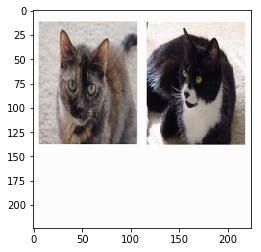

Class: Labrador retriever, prop:0.826
Class: golden retriever, prop:0.063
Class: beagle, prop:0.030
Class: tennis ball, prop:0.005
Class: kuvasz, prop:0.004


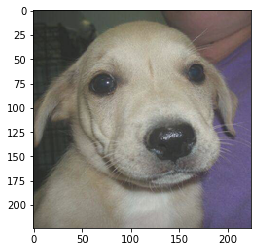

In [5]:
X_features = model.predict(X)

# check whether results make sense
cat_i = np.random.randint(10)
dog_i = np.random.randint(10, 20)

plt.imshow(vgg_to_img(X[cat_i]))
top_preds = np.sort(X_features[cat_i])[::-1][:5]
for prob in top_preds:
    class_name = classes[np.argwhere(np.isclose(prob, X_features[cat_i]))]
    print('Class: {}, prop:{:.3f}'.format(class_name[0][0], prob))
plt.show()
    
plt.imshow(vgg_to_img(X[dog_i]))
top_preds = np.sort(X_features[dog_i])[::-1][:5]
for prob in top_preds:
    class_name = classes[np.argwhere(np.isclose(prob, X_features[dog_i]))]
    print('Class: {}, prop:{:.3f}'.format(class_name[0][0], prob))

Load previously trained neural network (consisting of a single dense layer and softmax) that uses vgg16 output to understand whether we have a cat or dog picture.

In [6]:
catdog_model = K.models.load_model('cat_dog_model.h5')

predictions = catdog_model.predict(X_features)
print(predictions.shape) # one hot predictions, col[0] = P(cat)

Instructions for updating:
keep_dims is deprecated, use keepdims instead
(20, 2)


# Explaining model

In [ ]:
from lime import lime_tabular

explainer = lime_tabular.LimeTabularExplainer(X_features,
                                              feature_names=classes, 
                                              discretizer='decile',                                               
                                              class_names=['cat','dog'])



Picture: 0


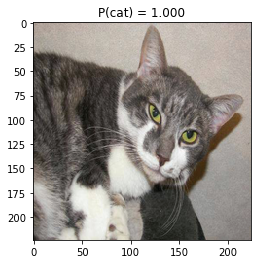



Picture: 1


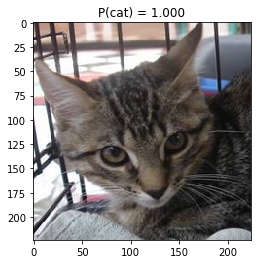



Picture: 2


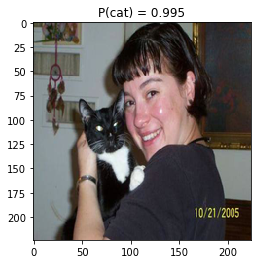



Picture: 3


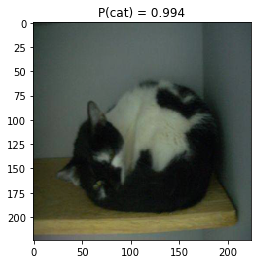



Picture: 4


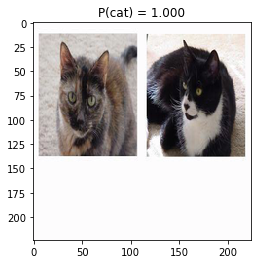



Picture: 5


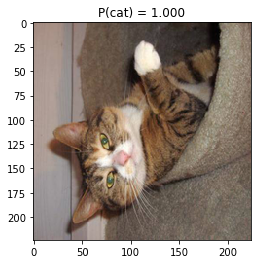



Picture: 6


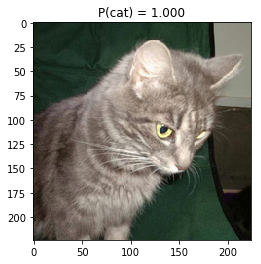



Picture: 7


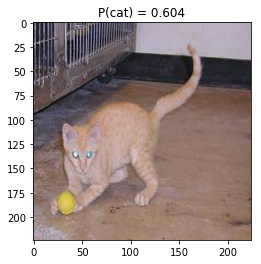



Picture: 8


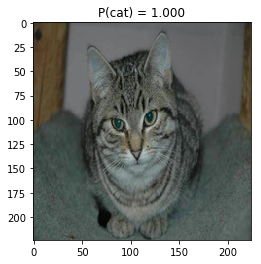



Picture: 9


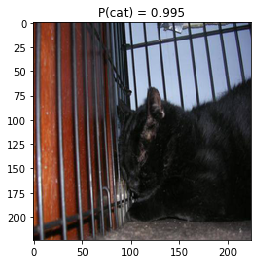



Picture: 10


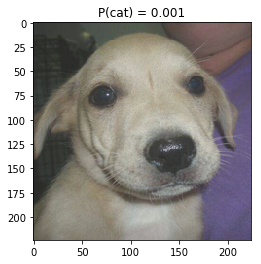



Picture: 11


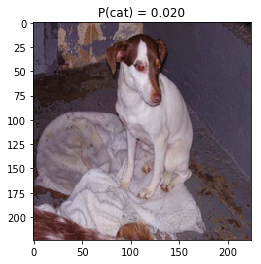



Picture: 12


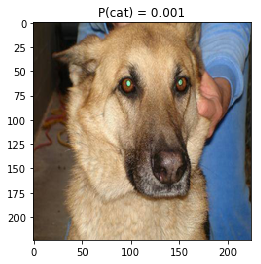



Picture: 13


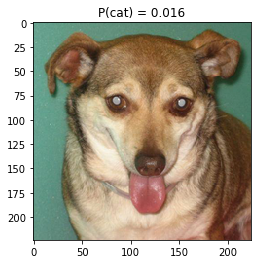



Picture: 14


In [ ]:
for i, (img, vgg_out, pred) in enumerate(zip(X, X_features, predictions)):
    print('\n\nPicture:',i)
    exp = explainer.explain_instance(vgg_out,
                                     catdog_model.predict,
                                     top_labels=1)
    plt.imshow(vgg_to_img(img))
    plt.title('P(cat) = {:.3f}'.format(pred[0]))
    plt.show()
    exp.show_in_notebook()